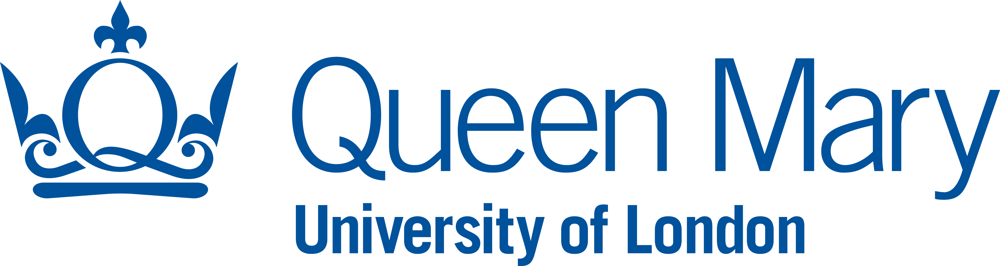

# MTH766P: Programming with Python 2020/21

## Final Report Project: "Deposition Models"

### Instructions:

First, please type your name and student number into the Markdown cell below:

**Name:** Kasi Viswanath Chennupati

**Student number:** 200653723

You must write your answers in this Jupyter Notebook, using either Python code or Markdown, as appropriate. (We have left blank code and/or Markdown cells for you, but you may also create additional cells if you feel you need to.)

Your code must be **well documented**. As a rough guide, you should aim to include one line of comments for each line of code. 

You should also use **sensible variable names**, so that your code is as clear as possible. If your code works but is difficult to read, then you will lose some points.

### Submission deadline:

You must submit your work via QMPlus, to the "Final Report Project" assignment in the "Final Report Project" section under the "Module Content" tab (top of the page).

The submission deadline is **11:59pm on Friday 15 January, 2021**. Late submissions will be penalised according to the School's [guidelines](https://qmplus.qmul.ac.uk/mod/book/view.php?id=807735&chapterid=89105):

*According to the current QMUL College Regulations, late submissions will be penalised with the withdrawal of 5% of the possible total mark for each 24 hours of delay, or fractions thereof, up to a maximum of 7 (seven) days. Any submission received more than 168 hours after the set deadline will score zero.*

Your lecturer will respond to project-related emails until 5:00pm on Wednesday 13 January, 2021, only. You should aim to have your project finished by this time.

### Marking:

The project is worth 50% of your final mark for this module.

The total number of marks available for the project is 100. Attempt all parts of all questions.

When writing up your project, good writing style is even more important than in written exams. 
According to the [advice in the student handbook](https://qmplus.qmul.ac.uk/mod/book/view.php?id=807735&chapterid=87786),

> To get full marks in any assessed work (tests or exams) you must normally not only give the right answers but also explain your working clearly and give reasons for your answers by writing legible and grammatically correct English sentences. Mathematics is about logic and reasoned arguments and the only way to present a reasoned and logical argument is by writing about it clearly. Your writing may include numbers and other mathematical symbols, but they are not enough on their own. You should copy the writing style used in good mathematical textbooks, such as those recommended for your modules. **You can expect to lose marks for poor writing (incorrect grammar and spelling) as well as for poor mathematics (incorrect or unclear logic).**

### Plagiarism warning:

Your work will be tested for plagiarism, which is an assessment offence, according to the [School's policy on Plagiarism](https://qmplus.qmul.ac.uk/mod/book/view.php?id=807735&chapterid=87787). In particular, while only academic staff will make a judgement on whether plagiarism has occurred in a piece of work, we will use the software "Turnitin" to help us assess how much of your work matches other sources. You will have the opportunity to upload your work, see the Turnitin result, and edit your work accordingly before finalising your submission.

If necessary, you may summarise relevant parts of books, online notes or other resources.
However, you must use your own words as far as possible, and you **must** [reference](https://qmplus.qmul.ac.uk/mod/book/view.php?id=807735&chapterid=87793) any sources that you use. If you decide to work with other students on parts of the project, then you **must** write up your work individually. 

You should also note that some of the questions are personalised in the sense that you will need to import and manipulate data that will be unique to you (i.e. no other student will have the same data).

[1]: http://www.ams.org/publicoutreach/feature-column/fc-2016-02
[2]: https://arxiv.org/ftp/arxiv/papers/1606/1606.06602.pdf
## Background information

In this project you will learn about a field of mathematical physics called [AMS review paper][1]. 
(You may read the linked article for an introduction as well as [Review by Ivan Corwin][2].)

In this project we will deal with two important classes of deposition models: random deposition model and ballistic deposition model. The first one is the easiest type of deposition models, while the second one is commonly used for simulating different sorts of growing surfaces, such as turbulent liquid crystals, crystal growth on a thin film, facet boundaries, bacteria colony growth, paper wetting, crack formation, and burning fronts.

### Random deposition model 

Random deposition model consist of a manifold and objects randomly falling on it at random times. We start with the simplest possible model, namely unit squares falling on one-dimensional integer lattice. 

This random deposition growth model involves square blocks being stacked in columns (indexed by $\mathbb{Z}$). Growth is driven by independent Poisson processes (one for each column) of blocks falling from above and accumulating on top of the growing stacks of blocks.

We define our model on a finite interval of integer lattice of length $N$, e.g. on the interval $[0, N]$. We enumerate corresponding columns with $i = 1,2,\ldots,N$, i.e. the column that stands over the interval $[i-1,i]$ has an index $i$. We will be mostly interested in the height function $h(i,T)$, $i=1,2,\ldots, N$, $T\geq 0$, which is equal to the number of blocks that had fallen at the interval $[i-1,i]$ up to time $T$. Every column has independent "exponential" clocks associated with it. These clocks ring at a random time generated by a Poisson process with intensity $1$. After they ring one more block falls from above corresponding column. Graphically it may be represented as

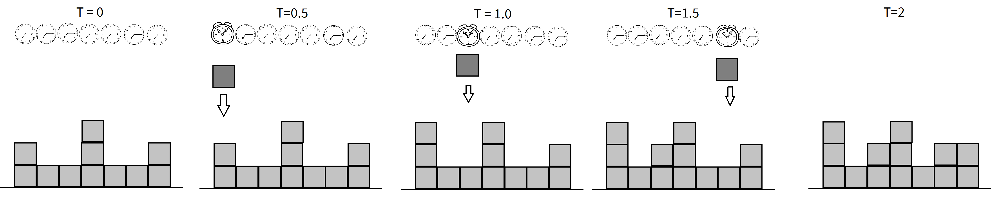

**Remark**: The Poisson process is set up to have intensity $1$ to ensure that in average we observe $1$ block falling at each column during one unit of time.

**Example**: In the example above $N = 7$. Let us assume that clocks ring at times $t = 0.5; 1; 1.5$. Then:  
1. for $0\leq T < 0.5$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    2, & i = 1, \\
    1, & i = 2, \\
    1, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    1, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$
2. for $0.5\leq T < 1$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    3, & i = 1, \\
    1, & i = 2, \\
    1, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    1, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$
3. for $1\leq T < 1.5$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    3, & i = 1, \\
    1, & i = 2, \\
    2, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    1, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$
4. for $1.5\leq T$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    3, & i = 1, \\
    1, & i = 2, \\
    2, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    2, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$

### Ballistic deposition model

In this project we will also consider ballistic deposition model, i.e. random deposition model with "sticky" blocks. As before, blocks fall according to independent identically distributed exponential waiting times, however, now a block will stick to the first edge against which it becomes incident. Graphically it may be represented as

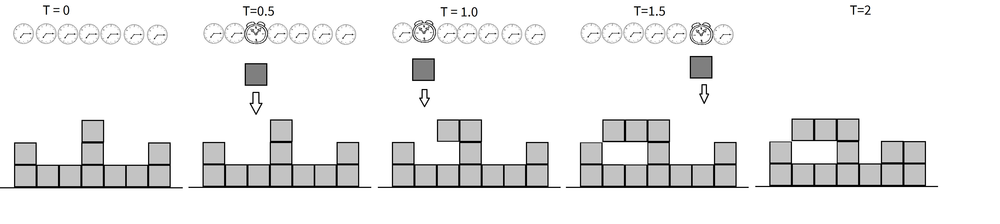

In general, the speed of growth in ballistic deposition model would be larger than the one in random deposition model. This is due to a fact that in ballistic deposition model we allow gaps between blocks in the same column. In Ballistic deposition model by height function $h\left(i, T\right)$ we will mean the height of corresponding column including gaps.

**Example**: In the example above $N = 7$. Let us assume that clocks ring at times $t = 0.5; 1; 1.5$. Then:  
1. for $0\leq T < 0.5$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    2, & i = 1, \\
    1, & i = 2, \\
    1, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    1, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$
2. for $0.5\leq T < 1$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    2, & i = 1, \\
    1, & i = 2, \\
    3, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    1, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$
3. for $1\leq T < 1.5$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    2, & i = 1, \\
    3, & i = 2, \\
    3, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    1, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$
4. for $1.5\leq T$ one has
$$
h\left(i,T\right) = 
\begin{cases}
    2, & i = 1, \\
    3, & i = 2, \\
    3, & i = 3, \\
    3, & i = 4, \\
    1, & i = 5, \\
    2, & i = 6, \\
    2, & i = 7, \\
\end{cases}
$$

It turns out that sticky blocks radically change the limiting behavior of this growth process. And our main goal is to compare statistical properties of the height function in the two models. We will finish the project by animating both growth processes.

### Some code to get you started

The two models we discussed above could be described in terms of a height function and a list of times before the next alarm ringing/block falling. Let the configuration of the deposition model being described as:

- Integer number ```Size ```: defining size of the system ($N$ in above examples)
- Floating point number ```Time```: defining current time ($T$ in above examples)
- Numpy array ```Heights``` of length ```Size```: defining height of a corresponding column
- Numpy array ```Clocks``` of length ```Size```: defining next time the clocks will ring at a corresponding column
- Integer number ```NextBlock``` in the range ```0...Size-1```: defining the column number where the next block will fall

You need to **import** some modules before progressing to the code:

In [1]:
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
from scipy import stats as stats

#### Parent class  
In this project we use OOP methodology. Both models have identical structure and the only difference is in the rule how do new blocks attach to the blocks that already had fallen. Thus it makes sense to define a parent class **Deposition** and then two child classes **RandomDeposition** and **BallisticDeposition**.

In [2]:
class Deposition:
    
# --------------------------------------------------------------------------------        
    def __init__(self, size):
        if (not (isinstance(size, int)) or size <= 0):
            raise ValueError ("The size of the model should be positive integer.")
        
        self.Size = size
        self.Heights = np.zeros(size, dtype = 'int')
        self.CurrentTime = 0
        
        self.Times = np.random.exponential(scale = 1, size = size)
        self.NextBrick = np.argmin(self.Times)
        
# --------------------------------------------------------------------------------
    def __str__(self):
        return "At T = {:.2f} the height function is {}"\
                .format(self.CurrentTime,self.Heights)
        
# --------------------------------------------------------------------------------        
    def UpdateHeights(self, index):
        raise NotImplementedError ("The method is not implemented")

# --------------------------------------------------------------------------------    
    def UpdateConfiguration(self, dt):
        TimeToNextBrick = self.Times[self.NextBrick]
        
        if (dt<TimeToNextBrick):
            self.Times -= dt
            self.CurrentTime += dt
        else:
            self.Times -= TimeToNextBrick
            self.CurrentTime += TimeToNextBrick
            
            y1 = self.Heights.copy()
            
            self.UpdateHeights(self.NextBrick) 
            
            y2 = self.Heights
            y = self.Heights[(y2-y1).argmax()]
            self.DrawASquare(self.NextBrick,y)
            
            self.Times[self.NextBrick] = np.random.exponential(scale = 1)            
            self.NextBrick = np.argmin(self.Times)
            
            self.UpdateConfiguration(dt-TimeToNextBrick)
            
            
    def DrawASquare(self, x,y,color='b',alpha=0.5):
        
        try:  # The try is used so if the generic random or ballistic deposition is executed the code will not run into a error due to missing ax or matplotlib references
            ax.add_patch(plt.Rectangle((x,y),1,1,fill = True, alpha = alpha, facecolor = color, edgecolor = color))
        except:
            pass
            
    def Animate(self,i):
        self.UpdateConfiguration(1)
        #line.set_data(np.arange(self.Size+1),self.Heights[i])
        return line,

    def InitializeDraw(self):
        #line.set_data(np.arange(self.Size+1),self.Heights+1)
        return line,

    

#### RandomDeposition class

In [3]:
class RandomDeposition(Deposition):
    
# --------------------------------------------------------------------------------            
    def UpdateHeights(self, index):
        self.Heights[index] = self.Heights[index]+1   

Notice that the above code is uncommented. This is because one of your tasks is to clearly explain what each line of this code does (see Question 1 below).

First let's use the ```class RandomDeposition``` to create the instance of Random Deposition model.

In [4]:
RandomDepositionModel = RandomDeposition(10)

We can now update it in time. Let us update it 10 times for 10 units of time each time.

In [5]:
M = 10
T = 10
for i in range(M):
    RandomDepositionModel.UpdateConfiguration(T)
    print(RandomDepositionModel)

At T = 10.00 the height function is [13 13  7 11 10  9 15  8 16  9]
At T = 20.00 the height function is [27 26 24 18 16 21 30 15 20 16]
At T = 30.00 the height function is [44 37 33 29 21 32 40 21 28 28]
At T = 40.00 the height function is [51 43 40 43 25 42 51 32 43 40]
At T = 50.00 the height function is [58 56 53 56 35 54 59 40 50 46]
At T = 60.00 the height function is [68 65 60 65 52 66 68 55 61 51]
At T = 70.00 the height function is [80 74 68 76 66 72 76 68 69 59]
At T = 80.00 the height function is [93 77 77 84 75 85 86 75 79 74]
At T = 90.00 the height function is [104  88  85  92  87  90  91  82  87  84]
At T = 100.00 the height function is [116  99  94 109  95 102 103  89  95  89]


Every time you initialize an instance of class RandomDeposition and update it in time, you have a random value of the height function. We aim to study statistical properties of the function in details. In the meanwhile you can plot some samples by running below code: <a id="model_plot"></a>

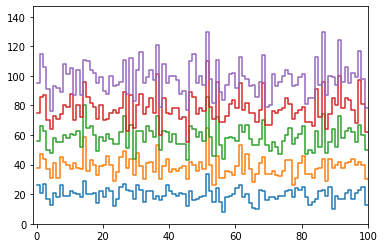

In [6]:
N = 100
M = 5
T = 20

#generating the model
RandomDepositionModel = RandomDeposition(N)


#initialize drawing
plt.axes(xlim = (-1, N), ylim = (0, (T+1)*(M+2))) 
# the axes are set by experimenting. 
# don't try to interpret (M+2)*(T+1) as something model specific

#updating and drawing
for i in range(M):
    RandomDepositionModel.UpdateConfiguration(T)
    plt.step(np.arange(N+1), np.append(RandomDepositionModel.Heights,\
                    RandomDepositionModel.Heights[-1]), where='post')

#showing the plot
plt.show()

**Remark**: When running simulations try to omit situations when time increment is set up to be more than $10^3/N$. Otherwise you may get ```RecursionError: maximum recursion depth exceeded```. If this is the case, try to reduce the size of the system or decrease the time increment size.

# The project

We now outline your specific tasks for the project. These are broken up into four parts, each containing several questions. Remember that you should attempt each part of each question. Read the questions carefully and make sure to answer everything that is asked.

### Part I: Random deposition model and its statistical properties [35 marks]

**1. [20 marks]** Explain in detail how the classes `Deposition`, `RandomDeposition` are organised and how the related code defined above works. More specifically:
- Explain the purpose of the class `Deposition`.**[3 marks]**
- Explain the purpose of the method \_\_init\_\_ . In particular explain assignments:**[3 marks]**  
     
>self.Size = size  
>self.Heights = np.zeros(size, dtype = 'int')  
>self.CurrentTime = 0  
>self.Times = np.random.exponential(scale = 1, size = size)  
>self.NextBrick = np.argmin(self.Times)  

- Explain the purpose of the method \_\_str\_\_ . **[1 mark]** 
- Explain the purpose of the method `UpdateHeights` and the way it is defined. In particular:  
    - Explain the purpose of the method. **[1 mark]** _Hint_: find precise position in the code where we use this method.
    - Explain why is it implemented to raise an error in ```Deposition class```. **[1 mark]**
    - Explain how does it work with instances of ```RandomDeposition classes```. **[1 mark]**
- Explain how the method `UpdateConfiguration` works. In particular:
    - Describe the input parameters of this function, in particular the meaning of `dt`. **[1 mark]**
    - Explain the purpose of the variable `TimeToNextBrick`. **[1 mark]**
    - Explain the purpose of the code block **[2 marks]**
        > self.UpdateHeights(self.NextBrick)   
        > self.Times[self.NextBrick] = np.random.exponential(scale = 1)              
        > self.NextBrick = np.argmin(self.Times)  
    - Most importantly, explain the meaning of `self.UpdateConfiguration(dt-TimeToNextBrick)`. What does this line imply for the way the method ```UpdateConfiguration``` works. **[3 marks]**
- Explain how the method ```UpdateHeights``` is implemented in the class ```RandomDeposition```. In particular explain why is it implemented in this way. **[2 marks]**
- Define ```RandomDepositionModel``` to be an instance of the ```class RandomDeposition``` of the Size = 10. Call 
```python 
RandomDepositionModel.UpdateConfiguration(10)
print(RandomDepositionModel)
``` 
and comment on the output. **[1 mark]**

Your explanation(s) should make it clear how the `class Deposition`, `class RandomDeposition` is actually defined, how is an instance of corresponding class updated in time. For example, it is not enough to say "the `Deposition` class is a class to work with Deposition models" or "the method `UpdateConfiguration` updates a configuration" . That is obvious. You should instead explain what information does the instance of `class Deposition` holds or how are the parameters values of the method `UpdateConfiguration` imply the result of update.

### Part I: Q1 Answers

#### Explain the purpose of the class Deposition?
<span style = color:green>Answer</span>




[1]: http://www.ams.org/publicoutreach/feature-column/fc-2016-02
[2]: https://arxiv.org/ftp/arxiv/papers/1606/1606.06602.pdf
**2. [15 marks]** In this section we investigate statistical properties of the height function. As you may have seen in [AMS Review][1] and [Ivan Corwin review][2] we expect $h\left(x, T\right)$ being independent, for different $x$, normal random variables with mean $T$  and variance $\sqrt{T}$.

We start by fixing $N = 100$ and $M = 400$. These would be the size of the model and the number of experiments to run. We also fix $T=64=2^6$ and $dt=1$. These would be the time until which we simulate the growth model and the time step for every call of ```UpdateConfiguration``` method.

In [7]:
N = 100
M = 400
T = 64
dt = 1

We are now ready to simulate the growth process and run corresponding statistical analysis <a id="model_stats"></a>

In [8]:
Column1 = 20
Column2 = 40
Column3 = 60
Data1 = []
Data2 = []
Data3 = []

for m in range(M):
    RandomDepositionModel = RandomDeposition(N)
    for j in range(int(T/dt)):
        RandomDepositionModel.UpdateConfiguration(dt)
    Data1.append((RandomDepositionModel.Heights[Column1]-T)/np.sqrt(T))
    Data2.append((RandomDepositionModel.Heights[Column2]-T)/np.sqrt(T))
    Data3.append((RandomDepositionModel.Heights[Column3]-T)/np.sqrt(T))

- Explain what data do we collect in the above. Specifically, what are Data1, Data2, Data3. **[3 marks]**
- Build three histograms corresponding to Data1, Data2, Data3 and pairwise scatter plots for pairs (Data1, Data2); (Data1, Data3); (Data2, Data3). Please use seaborn package for a better presentation. **[6 marks]**
- Use the above figures to confirm the hypothesis about the statistical properties of the height function in random deposition model. Confirm your hypothesis by fitting to normal distribution to Data1, Data2, Data3. Run the [Shapiro-Wilk](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.shapiro.html) test to check the quality of fitting. **[3 marks]**
- Using the above figures confirm the hypothesis about the correlation of the height function values corresponding to different columns. Confirm your hypothesis by calculating a correlation matrix for Data1, Data2, Data3. **[3 marks]**

[1]: http://www.ams.org/publicoutreach/feature-column/fc-2016-02
[2]: https://arxiv.org/ftp/arxiv/papers/1606/1606.06602.pdf

### Part 2: Ballistic deposition model and its statistical properties. [35 marks]

Let us remind that ballistic deposition model is different from random deposition model by the rule by which a new block is added to the configuration. In this section you are supposed to write your own code that will define the way a block is added and perform further statistical analysis.

**3. [15 marks]** Let us define a new ```class BallisticDeposition``` as follows.

In [9]:
class BallisticDeposition(Deposition):
    
# --------------------------------------------------------------------------------            
    def UpdateHeights(self, index):
        #add your code here
        """
        The Ballistic Deposition observes the heights of the neighbours and allows gapps in the columns.
        Due to this the current block column need to be compared with: 
            
            immediate left(i-1)  columns
            immediate right(i+1) columns
        
        Class type : Child Class 
        input:
                The function takes an Integer (index)
                
        Functionality:
                The function updates the Height of the 
        """
        # get the index positions for left, current and right neighbours
        # The index position of the neighbours is dependent on the current column position.
        #
        left_nbr_idx = self.Size-1 if index == 0 else index-1   # This is the i-1 column
        curr_col_idx = index                                    # This is the i   column
        rght_nbr_idx = 0 if index == self.Size-1 else index+1   # This is the i+1 column     
        
        # Heights
        a = self.Heights[left_nbr_idx]
        b = self.Heights[curr_col_idx]
        c = self.Heights[rght_nbr_idx]
        
        #Heights list 

        heights_list = [a,b,c]   #Heights of the i-1, i, i+1 are loaded in to a list
        
        #Check for maximum values in out of three column heights
        
        max_val = max(heights_list)  # Returns the maximum height out of the three column heights
        max_idx = [i for i, j in enumerate(heights_list) if j == max_val]   #returns a list of index positions of maximum value
        

        if 1 in max_idx:
            self.Heights[curr_col_idx] += 1

        else:
            self.Heights[curr_col_idx] = max_val
        
        #Hint1: check whether the block falls into one of extreme columns 
        # (first or last)
        #Hint2: if the block is falling into column i, check current 
        # heights of columns i-1 and i+1
        #Hint3: let the heights of these three columns be a,b,c. 
        # Which position would a new block occupy?


- Fill the missing part by following the hints given. Comment your code accordingly. **[10 marks]**
- Create an instance of BallisticDeposition class. Run the simulation of the model and plot it by following the same lines as in the [above](#model_plot). Convince yourself that ballistic deposition model has a higher growth speed than a random deposition model. Explain how would you observe it. **[5 marks]**

[1]: http://www.ams.org/publicoutreach/feature-column/fc-2016-02
[2]: https://arxiv.org/ftp/arxiv/papers/1606/1606.06602.pdf

**4. [20 marks]** In this section we investigate statistical properties of the height function in ballistic deposition model. As you may have seen in [AMS Review][1] and [Ivan Corwin review][2] we expect  $h(x,T)$ having different behaviour from random deposition model.

We start by fixing  $N=100$  and  $M=400$. These would be the size of the model and the number of experiments to run. At the first stage we would like to find a speed of the growth. It is predicted that
$$
    h\left(x,T\right)\sim c_1 T,
$$
with unknown constant $c_1$.

- Create an instance of BallisticDeposition class of size $N$. Call it BallisticDepositionModel. **[2 marks]**
- Fix $T = 64$ as before. Simulate growth of the BallisticDepositionModel (use UpdateConfiguration() method) in time $T$ and record the height of the $50^{th}$ column divided by $T$. Append corresponding values to a Data array. **[2 marks]**
- Repeat the above for $M$ times and calculate the average of an array you have obtained. This would be an estimate for the value of $c_1$. **[2 marks]**
- Repeat the same experiment for $T=128$, $T=256$, $T=512$.   
_Remark_: execution of the code would not be immediate, it can take couple of minutes to execute.**[2 marks]**
- Estimate a real value of $c_1$ as the one corresponding to $T = 512$. **[2 marks]**

_Hint_: we provide the skeleton of the code for the last two questions for you to fill the gaps

```python
N = 100
M = 400
T = 64
Times = [64,128,256,512]
dt = 1
Data = []

for ....: # study the growth for corresponding t in Times  
    for ....: # repeat the experiment M times
        BallisticDepositionModel = #create an instance of BallisticDeposition class
        for ....: #make small dt steps (t/dt times) to omit recursion problems
            ..... #simulate the growth
        Data.append(...) #add a scaled (divided by t) height function to an array
    c1 = # calculate the mean value of Data
    # store or print c1
```

In [10]:
N = 100
M = 400
T = 64
Times = [64,128,256,512]
dt = 1
Data = []

for t in Times: # study the growth for corresponding t in Times  
    for m in range(M): # repeat the experiment M times
        BallisticDepositionModel = BallisticDeposition(N)#create an instance of BallisticDeposition class
        for t in range(int(T/dt)): #make small dt steps (t/dt times) to omit recursion problems
            BallisticDepositionModel.UpdateConfiguration(dt) #simulate the growth
        Data.append((BallisticDepositionModel.Heights[51]/T)) #add a scaled (divided by t) height function to an array
    c1 = sum(Data)/len(Data)# calculate the mean value of Data
    # store or print c1
    print(c1)

2.0503515625
2.046875
2.044283854166667
2.043291015625


- Repeat the [statistical analysis](#model_stats), we performed above for a random depositoin model, in the case of ballistic deposition model. In particular,
    - Fix $N = 100$, $M = 400$, $T = 64$, $dt = 1$ and column numbers Column1=20, Column2=40, Column3=60. Collect the data about corresponding heights. **Make sure** you rescale the height function as $h\left(x,T\right) = (h\left(x,T\right)-c_1T)/\sqrt[3]{T}$ as this is the right scale for ballistic deposition model. Use the value of $c_1$ you have found above. _Remark_ only if you have not calculated $c_1$ in the above, please use $c_1 = 2$. **[4 marks]**
    - Build three histograms corresponding to Data1, Data2, Data3 columns and calculate corresponding correlation matrix. **[4 marks]**
    - What do you observe? **[2 marks]**

### Part III: Animation of the growth [15 marks]

In this section we will animate our growth processes. The animation is performed in the same way for both models and thus we will update the parent ```class Deposition``` only. 

To run the animation you need to run the following code: 
<a id="model_animate"></a>
```python
%matplotlib inline
from matplotlib import animation as animation
from IPython.display import HTML
from matplotlib import rc
rc('animation', html='html5')

DepositionModel = #setup a model to animate

# First set up the figure and the plot element we want to animate
fig = plt.figure()
ax = plt.axes()
line, = ax.step([], [], lw=2, where = 'post')

#call the animator

anim = animation.FuncAnimation(fig, DepositionModel.Animate, init_func=DepositionModel.InitializeDraw,frames= <put your code>, interval=<put your code>, blit=True)
anim
```

**Remark**: You may also wish to setup ```ax.xlim``` and ```ax.ylim``` accordingly.

**1. [5 marks]** In the above code you can spot that the DepositionModel has two associate methods that were never defined. You should add them to a corresponding place of your code. **[5 marks]**

- ```InitializeDraw```: this method animates the first frame of the animation. If the model has no blocks yet, then this method doesn't perform any job. We will animate our model starting from an empty surface and thus this method would be "almost empty".
```python
def InitializeDraw(self):
    return line,
```
- ```Animate```: this method animates the model growth. At the moment the block is added we will need to draw it. Instead of drawing the block inside of Animate method, we will do this at the moment the block is added in UpdateConfiguration() method. Thus animate method will only call UpdateConfiguration() method.
```python
def Animate(self,i):
        self.UpdateConfiguration(1)
        return line,
```

**2. [10 marks]** Before drawing a full configuration of a deposition model, we first need to draw a single block. This can be done by standard tools of matplotlib and the code you need to add to a ```Deposition``` class is given below.

```python
def DrawASquare(self, x,y,color='b',alpha=0.5):
        ax.add_patch(plt.Rectangle((x,y),1,1,fill = True, alpha = alpha, facecolor = color, edgecolor = color))
```
You now have all tools for drawing an animation:
- Comment DrawASquare method. In particular
    - explain what are the parameters x,y? **[1 mark]**
    - what do color='b', alpha = 0.5 mean? **[2 marks]**
- Specify precise line of the UpdateConfiguration() method where a new block is added to a model. Draw this block using DrawASquare method. **[3 marks]**
- Create an instance of RandomDeposition class and animate it using the above [code](#model_animate) **[2 marks]**
- Create an instance of BallisticDeposition class and animate it using the above [code](#model_animate) **[2 marks]**

## <span style=color:green>Part-III Answers</span>

<br>
<details>
    
<summary>Question</summary>
    explain what are the parameters x,y?
</details>

The parameters x, y are essentially the left and bottom coordinates of the rectangle we are plotting.
 for deriving the x,y parameters the following python code is written inthe UpdateConfiguration method
 ```python
     #Python Code block from Deposition UpdateConfiguration method
     x = self.NextBrick
     y1 = self.Heights.copy() 
     self.UpdateHeights(self.NextBrick)
     y2 = self.Heights
     y = self.Heights[(y2-y1).argmax()]
     
 ```
 

## <span style=color:green>Random Deposition Animation</span>

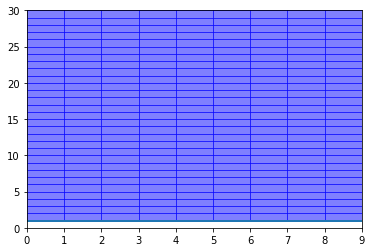

In [22]:
%matplotlib inline
from matplotlib import animation as animation
from IPython.display import HTML
from matplotlib import rc
rc('animation', html='html5')



N = 10
T = 10

DepositionModel = RandomDeposition(T)

fig = plt.figure()
ax = plt.axes()

y = np.append(DepositionModel.Heights,DepositionModel.Heights[-1])

line, = ax.step(np.arange(T+1), y+1, lw=2, where = 'post')
ax.set(xlim = (0,T-1),ylim = (0,3*T))

anim = animation.FuncAnimation(fig, DepositionModel.Animate, 
                        init_func=DepositionModel.InitializeDraw,
                        frames= 200, 
                        interval=1000, 
                        blit=True)
anim


In [20]:
Writer = animation.writers['ffmpeg']
writer = Writer(fps=15, metadata=dict(artist='Kasi Chennupati',id=200653723), bitrate=1800)

anim.save('Random_Deposition_Animation.mp4', writer=writer)

## <span style=color:green>Ballistic Deposition Animation</span>

In [ ]:
%matplotlib inline
from matplotlib import animation as animation
from IPython.display import HTML
from matplotlib import rc
rc('animation', html='html5')

DepositionModel = BallisticDeposition(10)

fig = plt.figure()
ax = plt.axes()

y = np.append(DepositionModel.Heights,DepositionModel.Heights[-1])

print("y value failed")

line, = ax.step(np.arange(10+1), y+1, lw=2, where = 'post')

print("error at line,  117")

ax.set(xlim = (0,10-1),ylim = (0,DepositionModel.Heights[DepositionModel.Heights.argmax()]+50)))


anim = animation.FuncAnimation(fig, DepositionModel.Animate, 
                        init_func=DepositionModel.InitializeDraw,
                        frames= 200, 
                        interval=1000, 
                        blit=True)
anim

### Part IV: The effect of initial data [15 marks]
Finally, you are asked to investigate the effect of random initial surface. You have been provided with a Python file called **"data.py"** on QMPlus, which you should **save in the same directory as this Jupyter notebook**.
This file contains a function `create_surface` which creates 'random' defects on the square lattice. (These look random, but will be unique to you, i.e. no two students will have the same defects to work with.)

**1. [5 marks]** Execute the following code cell to create your initial surface, storing the data in a list called `Heights`. You **must** replace the number "123456789" with your 9-digit student number. 

*Important note.* This question essentially gives you 5 free marks for typing your student ID correctly. If you do not do this correctly, you will score zero for this question, and if you instead use another student's ID, then your submission will be reviewed for plagiarism.

In [17]:
from data import create_surface

# Replace "123456789" below with your 9-digit student number

Heights = create_surface(200653723)

# Replace "123456789" above with your 9-digit student number

**2. [5 marks]** In this part we simulate random deposition model with given initial heights.
- Get the size of the configuration by calculating the length of Heights. Call it $N$. **[1 mark]**
- Create an instance of RandomDeposition class of size $N$. Call it RandomDepositionModel. **[1 mark]**
- Update Heights field of RandomDepositionModel with the Heights you have created above. **[1 mark]**
- Run the simulation of the model for $T = 200$. Calculate the average Height of the model. Is it different from what you would expect? **[2 marks]**

In [25]:
N = len(Heights)
T = 200

RandomDepositionModel = RandomDeposition(N)
RandomDepositionModel.Heights = Heights

for t in range(T):
    RandomDepositionModel.UpdateConfiguration(1)


**3. [5 marks]** Repeat the same for ballistic deposition model. Do you have any changes to the average height? Explain your answer. 

In [26]:
N = len(Heights)
T = 200

BallisticDepositionModel = BallisticDeposition(N)
BallisticDepositionModel.Heights = Heights

for t in range(T):
    BallisticDepositionModel.UpdateConfiguration(1)

References:  
1. [It Just Keeps Piling Up!, Bill Casselman][1]

2. [Kardar-Parizi-Zhang Universality, Ivan Corwin][2]

[1]: http://www.ams.org/publicoutreach/feature-column/fc-2016-02
[2]: https://arxiv.org/ftp/arxiv/papers/1606/1606.06602.pdf